# OpenCV video streaming
In this notebook we have a look at how to process video streams with opencv.

## Imports
Includes our own libraries

In [2]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

In [3]:
import os
import sys
module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(module_path)

from lib.imageutil import show_image

## Video streams
Here you can find a number of public webcam streams for testing:  
https://g33ktricks.blogspot.com/p/the-rtsp-real-time-streaming-protocol.html

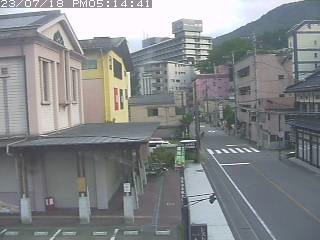

KeyboardInterrupt: 

In [9]:
import PIL
from io import StringIO
from time import time
from IPython.display import display, Image, HTML

stream_address = 'http://61.211.241.239/nphMotionJpeg?Resolution=320x240&Quality=Standard'
# stream_address = 'http://clausenrc5.viewnetcam.com:50003/nphMotionJpeg?Resolution=320x240'

capture = cv2.VideoCapture(stream_address);
main_display = display(None, display_id=1)
fps_display = display(None, display_id=2)

while(True):
    t_start = time()
    
    ret, frame = capture.read()
    if not ret:
        raise Exception("No frames read")

    _, frame = cv2.imencode('.jpeg', frame)
    main_display.update(Image(data=frame.tobytes()))

    t_end = time()
    
    fps_string = f"""{int(1 / (t_end - t_start))} FPS"""
    fps_display.update( HTML(fps_string) )

    if cv2.waitKey(1) == 13: #13 is the Enter Key
        break

# release camera and close windows
cap.release()
cv2.destroyAllWindows()   

## Import video from Youtube
There are a number of libraries to download video from youtube:
- https://pypi.org/project/pafy/ -> does not work at the moment because of problems with youtube-dl backend
- https://pypi.org/project/pytube

In [15]:
#!pip install youtube-dl==2021.12.17
#!pip install pafy
!pip install pytube

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.6/57.6 kB 4.0 MB/s eta 0:00:00


In [29]:
from pytube import YouTube
url = 'https://youtu.be/Od6EeCWytZo'

# YouTube(url).streams.first().download()
yt = YouTube(url)
output = yt.streams \
    .filter(progressive=True, file_extension='mp4') \
    .order_by('resolution') \
    .desc() \
    .first() \
    .download(output_path='./tmp/')

print(output)

/app/notebooks/./tmp/The famous Shibuya crossing - 90 seconds.mp4


In [30]:
from IPython.display import HTML
from base64 import b64encode

mp4 = open(output,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)